In [1]:
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go
import networkx as nx
import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np

# 1

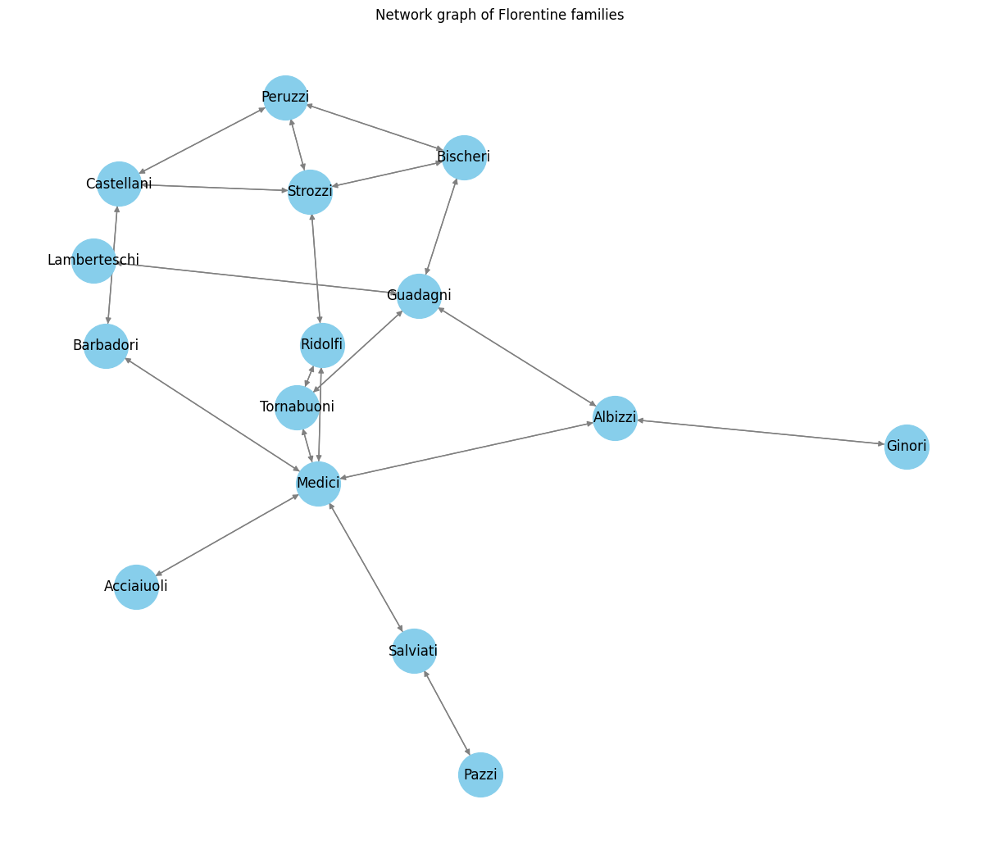

In [10]:
df1 = pd.read_csv('firenze.csv')
edges = []
for i in df1.columns:
    for j in df1.index:
        if df1.loc[j, i] == 1:
            edges.append((i, j))

G = nx.DiGraph()
G.add_edges_from(edges)

G.remove_edges_from(nx.selfloop_edges(G))

plt.figure(figsize=(12, 10))
nx.draw(G, with_labels=True, node_color='skyblue', node_size=1500, edge_color='gray')
plt.title("Network graph of Florentine families")
plt.show()


/tmp/ipykernel_22091/3010864945.py:5: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



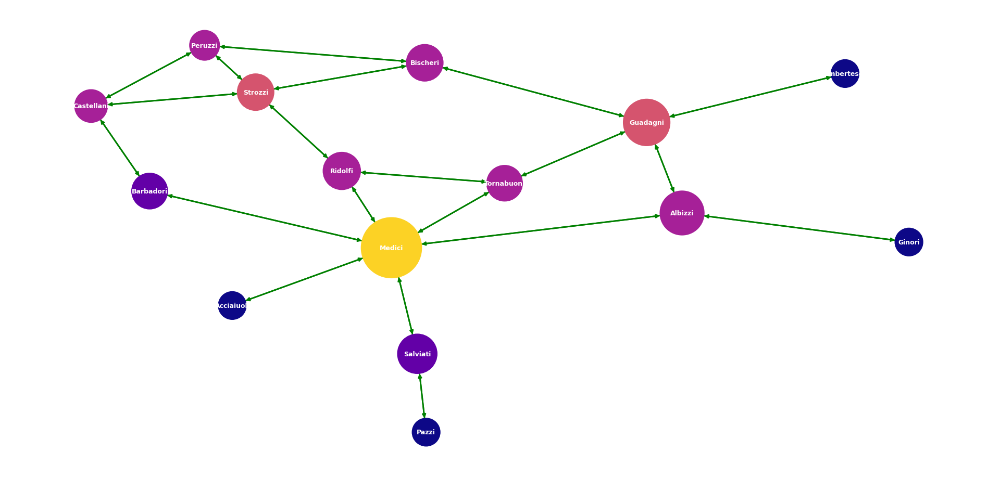

In [11]:
def rescale(l, newmin, newmax):
    arr = list(l)
    return [(x - min(arr)) / (max(arr) - min(arr)) * (newmax - newmin) + newmin for x in arr]

graph_colormap = cm.get_cmap('plasma', 12)  

c = rescale([G.degree(v) for v in G], 0.0, 0.9)  
c = [graph_colormap(i) for i in c]

bc = nx.betweenness_centrality(G)  
s = rescale([v for v in bc.values()], 1500, 7000)

pos = nx.spring_layout(G)
plt.figure(figsize=(19, 9), facecolor=[0.7, 0.7, 0.7, 0.4])
nx.draw(G, pos=pos, with_labels=True, node_color=c, node_size=s, edge_color='green', width=2,
        font_color='white', font_weight='bold', font_size=9)

plt.axis('off')
plt.show()


# 2

In [5]:
df2 = pd.read_csv('dothi3.csv')

df_filtered = df2[['preferredName_A', 'preferredName_B', 'score']]

df_array = np.array(df_filtered)

df_array

array([['TPH1', 'GRM2', 0.436],
       ['TPH1', 'HTR7', 0.607],
       ['TPH1', 'COMT', 0.636],
       ['TPH1', 'SLC18A2', 0.653],
       ['TPH1', 'HTR1A', 0.689],
       ['TPH1', 'MAOA', 0.729],
       ['TPH1', 'HTR2C', 0.844],
       ['TPH1', 'HTR1B', 0.895],
       ['TPH1', 'HTR2A', 0.901],
       ['TPH1', 'SLC6A4', 0.95],
       ['TPH1', 'TPH2', 0.96],
       ['GABBR2', 'HTR1A', 0.403],
       ['GABBR2', 'HTR2C', 0.439],
       ['GABBR2', 'SLC6A4', 0.542],
       ['GABBR2', 'GRM2', 0.66],
       ['GABBR2', 'GRM3', 0.705],
       ['GABBR2', 'NPY', 0.721],
       ['GABBR2', 'GNAI3', 0.936],
       ['GABBR2', 'GABBR1', 0.999],
       ['SLC6A4', 'GRM2', 0.4],
       ['SLC6A4', 'PDYN', 0.445],
       ['SLC6A4', 'NPY', 0.52],
       ['SLC6A4', 'POMC', 0.601],
       ['SLC6A4', 'HTR7', 0.645],
       ['SLC6A4', 'SLC18A2', 0.886],
       ['SLC6A4', 'HTR2C', 0.914],
       ['SLC6A4', 'TPH2', 0.925],
       ['SLC6A4', 'HTR1B', 0.932],
       ['SLC6A4', 'MAOA', 0.942],
       ['SLC6A4', 'COMT

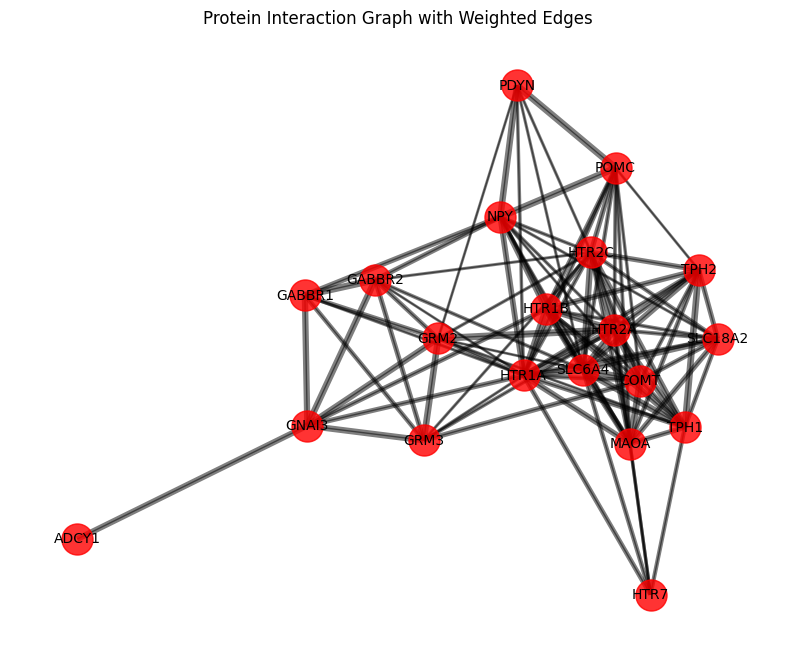

In [5]:
df2 = pd.read_csv('dothi3.csv')

df_filtered = df2[['preferredName_A', 'preferredName_B', 'score']]

df_array = np.array(df_filtered)

G = nx.Graph(name='Protein Interaction Graph')

for i in range(len(df_array)):
    a = df_array[i][0]
    b = df_array[i][1] 
    w = float(df_array[i][2]) 
    G.add_weighted_edges_from([(a, b, w)])

plt.figure(figsize=(10, 8))
pos = nx.spring_layout(G)  
edges = G.edges(data=True)
weights = [edge[2]['weight'] for edge in edges]
nx.draw_networkx_edges(G, pos, edgelist=edges, width=[w*5 for w in weights], alpha=0.5, edge_color='black')


nx.draw_networkx_nodes(G, pos, node_size=500, node_color='red', alpha=0.8)
nx.draw_networkx_edges(G, pos, width=1.0, alpha=0.5)
nx.draw_networkx_labels(G, pos, font_size=10)
plt.title("Protein Interaction Graph with Weighted Edges")
plt.axis('off')  
plt.show()

# 3

In [6]:
import json
df3 = pd.read_csv("Vietnam.csv")

with open('vietnam.geojson', 'r', encoding='utf-8') as f:
    vietnam_geojson = json.load(f)

fig = px.choropleth(df3,
                    geojson=vietnam_geojson,
                    locations='id',
                    featureidkey="properties.id_1",
                    color='province',
                    hover_name='province',
                    title="Population Distribution in Vietnam",
                    color_continuous_scale="Viridis")

fig.update_geos(fitbounds="locations", visible=False)
fig.show()


In [7]:
df32 = pd.read_csv('covid_hoanchinh.csv')
fig = px.choropleth(
    data_frame=df32,
    locations="ISO",  
    color="Deaths per Million",  
    hover_name="Country",  
    color_continuous_scale=px.colors.sequential.YlOrRd,  
    projection="natural earth"
)

fig.show()

In [8]:
fig = px.choropleth(
    data_frame=df32,
    locations="ISO",  
    color="Cases per Million",  
    hover_name="Country",  
    color_continuous_scale=px.colors.sequential.Plasma, 
    projection="natural earth"  
)

fig.show()

In [10]:
data = pd.read_csv('202004-divvy-tripdata.csv')
data

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,A847FADBBC638E45,docked_bike,4/26/2020 17:45,4/26/2020 18:12,Eckhart Park,86,Lincoln Ave & Diversey Pkwy,152.0,41.8964,-87.6610,41.9322,-87.6586,member
1,5405B80E996FF60D,docked_bike,4/17/2020 17:08,4/17/2020 17:17,Drake Ave & Fullerton Ave,503,Kosciuszko Park,499.0,41.9244,-87.7154,41.9306,-87.7238,member
2,5DD24A79A4E006F4,docked_bike,4/1/2020 17:54,4/1/2020 18:08,McClurg Ct & Erie St,142,Indiana Ave & Roosevelt Rd,255.0,41.8945,-87.6179,41.8679,-87.6230,member
3,2A59BBDF5CDBA725,docked_bike,4/7/2020 12:50,4/7/2020 13:02,California Ave & Division St,216,Wood St & Augusta Blvd,657.0,41.9030,-87.6975,41.8992,-87.6722,member
4,27AD306C119C6158,docked_bike,4/18/2020 10:22,4/18/2020 11:15,Rush St & Hubbard St,125,Sheridan Rd & Lawrence Ave,323.0,41.8902,-87.6262,41.9695,-87.6547,casual
...,...,...,...,...,...,...,...,...,...,...,...,...,...
84771,200E9CDFC5685AA0,docked_bike,4/16/2020 16:10,4/16/2020 16:23,Dearborn Pkwy & Delaware Pl,140,Dearborn Pkwy & Delaware Pl,140.0,41.8990,-87.6299,41.8990,-87.6299,member
84772,F58A8F2ABCB5D95B,docked_bike,4/30/2020 17:56,4/30/2020 18:15,Kimbark Ave & 53rd St,322,Cottage Grove Ave & 51st St,351.0,41.7996,-87.5947,41.8030,-87.6066,casual
84773,A3754693A80E4913,docked_bike,4/24/2020 19:57,4/24/2020 21:50,Sedgwick St & Schiller St,236,Wells St & Elm St,182.0,41.9076,-87.6386,41.9032,-87.6343,casual
84774,D610CABB67F7B744,docked_bike,4/2/2020 17:59,4/2/2020 18:42,Damen Ave & Charleston St,310,Damen Ave & Charleston St,310.0,41.9201,-87.6779,41.9201,-87.6779,casual


In [12]:
unique_stations = pd.concat([data['start_station_name'], data['end_station_name']]).unique()

total_stations = len(unique_stations)
total_stations


608

posx and posy should be finite values
posx and posy should be finite values


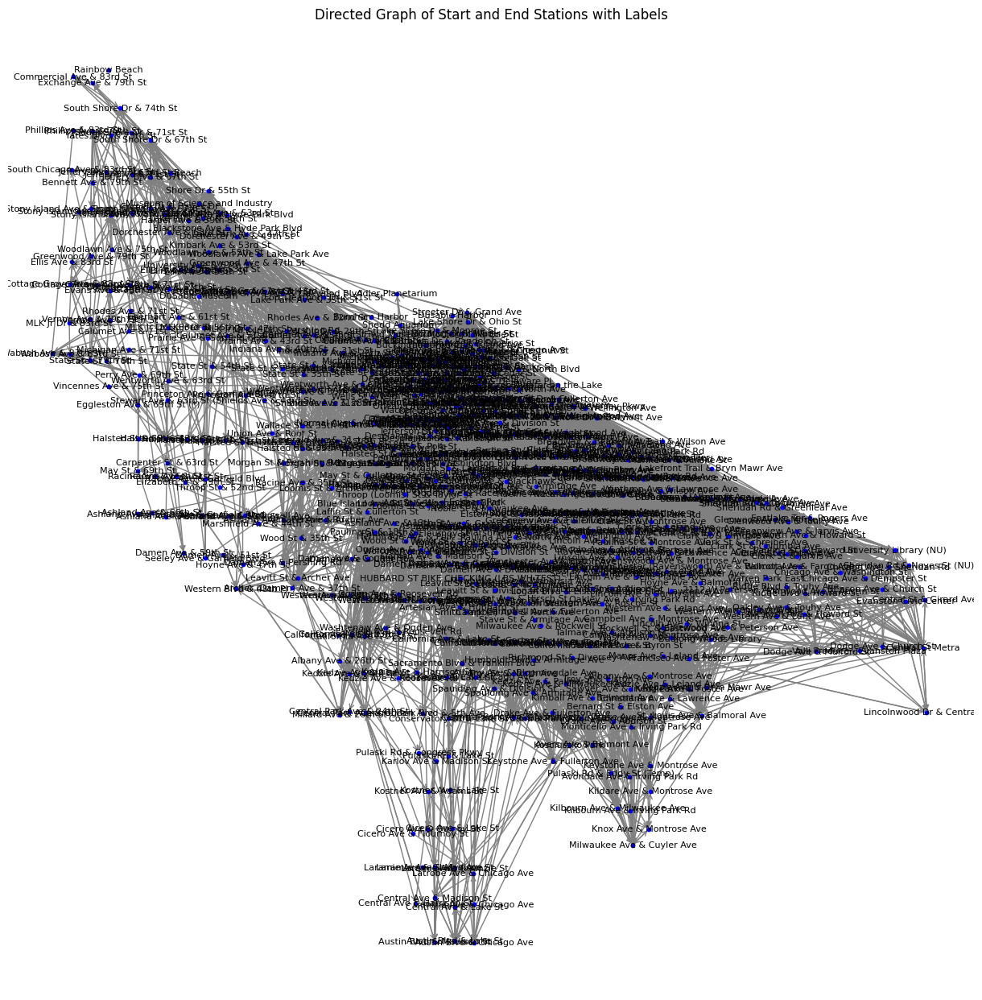

In [9]:
G = nx.DiGraph()

positions = {}

for i, row in data.iterrows():
    start_coords = (row['start_lat'], row['start_lng'])
    end_coords = (row['end_lat'], row['end_lng'])
    
    G.add_edge(row['start_station_name'], row['end_station_name'])
    
    positions[row['start_station_name']] = start_coords
    positions[row['end_station_name']] = end_coords

plt.figure(figsize=(12, 12))

nx.draw(G, pos=positions, with_labels=True, node_size=10, node_color='blue', edge_color='gray', arrows=True, arrowstyle='->', arrowsize=10, font_size=8)

plt.title('Directed Graph of Start and End Stations with Labels')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

plt.show()
